<a href="https://colab.research.google.com/github/BeverlyHuang/Explore-Zillow/blob/master/452_HW4_Beverly.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Explore Zillow

## Ingestion

In [0]:
import pandas as pd
pd.set_option('display.float_format', lambda x: '%.3f' % x)
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
from statsmodels.tsa.api import ExponentialSmoothing
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns; sns.set(color_codes=True)
from sklearn import linear_model
from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error
color = sns.color_palette()
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
%matplotlib inline

In [0]:
df = pd.read_csv("https://raw.githubusercontent.com/noahgift/real_estate_ml/master/data/Zip_Zhvi_SingleFamilyResidence_2018.csv")

## EDA

In [0]:
df.describe()

,RegionID,RegionName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
count,15508.000,15508.000,15508.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,14338.000,...,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000,15508.000
mean,80789.618,47683.566,7754.500,115889.866,116007.379,116123.051,116235.493,116358.920,116501.681,116689.315,...,279359.582,280672.685,282148.749,283446.447,284466.282,285500.200,286717.307,288029.320,289187.510,290106.635
std,31521.485,29008.034,4476.918,85115.825,85264.209,85413.118,85566.676,85744.243,85958.867,86230.630,...,361868.364,361360.576,363102.089,365301.815,366277.876,367095.613,366772.521,364624.171,361143.146,359132.687
min,58196.000,1001.000,1.000,11300.000,11500.000,11600.000,11800.000,11800.000,12000.000,12100.000,...,21700.000,21700.000,22100.000,22200.000,22000.000,21800.000,21700.000,21500.000,21600.000,21900.000
25%,67215.000,22199.000,3877.750,66700.000,66800.000,66925.000,67100.000,67200.000,67300.000,67500.000,...,128300.000,128800.000,129675.000,130300.000,131100.000,131900.000,132900.000,134000.000,135100.000,135600.000
50%,77886.500,45792.500,7754.500,96500.000,96700.000,96750.000,96900.000,96900.000,97000.000,97150.000,...,191100.000,192150.000,193400.000,194600.000,195700.000,196900.000,198100.000,199600.000,201100.000,202150.000
75%,90314.250,74010.250,11631.250,140500.000,140600.000,140600.000,140800.000,141000.000,141100.000,141300.000,...,310750.000,312300.000,314325.000,316100.000,317425.000,318325.000,319800.000,321200.000,322425.000,323900.000
max,753844.000,99901.000,15508.000,3676700.000,3704200.000,3729600.000,3754600.000,3781800.000,3813500.000,3849600.000,...,17724700.000,17408900.000,17450500.000,17722800.000,18006700.000,18273800.000,18331900.000,18131900.000,17594900.000,17119600.000


#### Clean Up DataFrame
Rename RegionName to ZipCode and Change Zip Code to String 

In [0]:
df.rename(columns={"RegionName":"ZipCode"}, inplace=True)
df["ZipCode"]=df["ZipCode"].map(lambda x: "{:.0f}".format(x))
df["RegionID"]=df["RegionID"].map(lambda x: "{:.0f}".format(x))
df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,...,1037400,1038700,1041500,1042800,1042900,1044400,1047800,1049700,1048300,1047900
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,...,330400,332700,334500,335900,337000,338300,338400,336900,336000,336500
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,...,1317900,1321100,1325300,1323800,1321200,1320700,1319500,1318800,1319700,1323300
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,...,120800,121300,122200,123000,123600,124500,125600,126300,126800,127400
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,...,175500,176400,176900,176900,177300,178000,178500,179300,180200,180700


In [0]:
median_prices = df.median()
#sf_prices = df["City"] == "San Francisco".median()

**Median USA Prices December, 2018**

In [0]:
median_prices.tail()

2018-08   196900.000
2018-09   198100.000
2018-10   199600.000
2018-11   201100.000
2018-12   202150.000
dtype: float64

In [0]:
sf_df = df[df["City"] == "San Francisco"].median()
df_comparison = pd.concat([sf_df,median_prices], axis=1)
df_comparison.columns = ["San Francisco","Median USA"]
df_comparison.tail()


,San Francisco,Median USA
2018-08,1828600.000,196900.000
2018-09,1823200.000,198100.000
2018-10,1823700.000,199600.000
2018-11,1813400.000,201100.000
2018-12,1806000.000,202150.000


### Visualize

In [0]:
!pip uninstall -q -y plotly
!pip install -q plotly
!pip install -q --upgrade cufflinks

In [0]:
def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
  '''))
  init_notebook_mode(connected=False)

In [0]:
from plotly.offline import init_notebook_mode
enable_plotly_in_cell()
init_notebook_mode(connected=False)

import cufflinks as cf
cf.go_offline()
df_comparison.iplot(title="Bay Area Median Single Family Home Prices 1996-2018",
                    xTitle="Year",
                    yTitle="Sales Price",
                   #bestfit=True, bestfit_colors=["pink"],
                   #subplots=True,
                   shape=(4,1),
                    #subplot_titles=True,
                    fill=True,)

### Cluster on Size Rank and Price


In [0]:
from sklearn.preprocessing import MinMaxScaler

In [0]:
columns_to_drop = ['RegionID', 'ZipCode', 'City', 'State', 'Metro', 'CountyName']
df_numerical = df.dropna()
df_numerical = df_numerical.drop(columns_to_drop, axis=1)

In [0]:
df_numerical.describe()

,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,...,2018-03,2018-04,2018-05,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12
count,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,...,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000,13254.000
mean,7209.201,119843.979,119964.886,120083.967,120200.023,120327.735,120475.887,120670.394,120896.748,121239.875,...,296637.596,298087.355,299639.037,300985.220,302016.350,303017.074,304232.096,305623.276,306889.113,307909.642
std,4415.323,86787.386,86943.535,87100.133,87261.531,87447.615,87671.976,87955.472,88287.690,88726.163,...,324511.156,325590.838,326899.476,327797.537,327909.039,327991.275,328048.196,327854.154,327338.204,327477.529
min,1.000,11400.000,11500.000,11600.000,11800.000,11800.000,12000.000,12100.000,12200.000,12300.000,...,21700.000,21700.000,22100.000,22600.000,23100.000,23700.000,24300.000,24400.000,24400.000,24600.000
25%,3393.250,70000.000,70100.000,70300.000,70400.000,70600.000,70800.000,71000.000,71200.000,71400.000,...,139100.000,139900.000,140725.000,141625.000,142600.000,143300.000,144225.000,145600.000,146700.000,147400.000
50%,6902.500,100750.000,100800.000,100800.000,101000.000,101000.000,101100.000,101200.000,101300.000,101400.000,...,208200.000,209700.000,211050.000,212700.000,213950.000,214900.000,216250.000,217800.000,219100.000,220000.000
75%,10921.750,144500.000,144600.000,144700.000,144800.000,144900.000,144975.000,145200.000,145500.000,145900.000,...,336300.000,337975.000,339900.000,341100.000,342000.000,342975.000,344275.000,345800.000,347750.000,348975.000
max,15508.000,3676700.000,3704200.000,3729600.000,3754600.000,3781800.000,3813500.000,3849600.000,3888900.000,3928800.000,...,7494200.000,7529400.000,7534400.000,7494600.000,7417200.000,7395700.000,7265400.000,6917500.000,6692700.000,6671700.000


In [0]:
scaler = MinMaxScaler()
scaled_df = scaler.fit_transform(df_numerical)
kmeans = KMeans(n_clusters=3, random_state=0).fit(scaled_df)
print(len(kmeans.labels_))

/usr/local/lib/python3.6/dist-packages/sklearn/preprocessing/data.py:323: DataConversionWarning:

Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.



13254


In [0]:
cluster_df = df.copy(deep=True)
cluster_df.dropna(inplace=True)
cluster_df.describe()
cluster_df['cluster'] = kmeans.labels_
cluster_df['appreciation_ratio'] = round(cluster_df["2017-09"]/cluster_df["1996-04"],2)
cluster_df['CityZipCodeAppRatio'] = cluster_df['City'].map(str) + "-" + cluster_df['ZipCode'] + "-" + cluster_df["appreciation_ratio"].map(str)
cluster_df.head()

,RegionID,ZipCode,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,...,2018-06,2018-07,2018-08,2018-09,2018-10,2018-11,2018-12,cluster,appreciation_ratio,CityZipCodeAppRatio
0,84654,60657,Chicago,IL,Chicago-Naperville-Elgin,Cook County,1,334200.000,335400.000,336500.000,...,1042800,1042900,1044400,1047800,1049700,1048300,1047900,1,3.020,Chicago-60657-3.02
1,91982,77494,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,2,210400.000,212200.000,212200.000,...,335900,337000,338300,338400,336900,336000,336500,0,1.520,Katy-77494-1.52
2,84616,60614,Chicago,IL,Chicago-Naperville-Elgin,Cook County,3,498100.000,500900.000,503100.000,...,1323800,1321200,1320700,1319500,1318800,1319700,1323300,1,2.590,Chicago-60614-2.59
3,93144,79936,El Paso,TX,El Paso,El Paso County,4,77300.000,77300.000,77300.000,...,123000,123600,124500,125600,126300,126800,127400,0,1.550,El Paso-79936-1.55
4,91940,77449,Katy,TX,Houston-The Woodlands-Sugar Land,Harris County,5,95400.000,95600.000,95800.000,...,176900,177300,178000,178500,179300,180200,180700,0,1.760,Katy-77449-1.76


In [0]:
import plotly.offline as py
import plotly.graph_objs as go
enable_plotly_in_cell()
trace1 = go.Scatter3d(
    x=cluster_df["appreciation_ratio"],
    y=cluster_df["1996-04"],
    z=cluster_df["2017-09"],
    mode='markers',
    text=cluster_df["CityZipCodeAppRatio"],
    marker=dict(
        size=12,
        color=cluster_df["cluster"],                # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8
    )
)
#print(trace1)
data = [trace1]
layout = go.Layout(
    showlegend=False,
    title="30 Year History USA Real Estate Prices (Clusters Colored)",
    scene = dict(
        xaxis = dict(title='X: Appreciation Ratio'),
        yaxis = dict(title="Y:  1996 Prices"),
        zaxis = dict(title="Z:  2017 Prices"),
    ),
    width=1000,
    height=900,
)
fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='3d-scatter-colorscale')

## Modeling





*   Create a time series forecast
*   Find a second model using traditional machine learning (can also find 3rd party data)
*   Nice to have (create a sophisticated prediction): https://www.kaggle.com/c/house-prices-advanced-regression-techniques




In [0]:
df_transposed = df.transpose()
df_transposed.head(10)

,0,1,2,3,4,5,6,7,8,9,...,15498,15499,15500,15501,15502,15503,15504,15505,15506,15507
RegionID,84654,91982,84616,93144,91940,91733,61807,84640,62037,97564,...,94711,62556,99032,62697,99074,58333,59107,75672,93733,95851
RegionName,60657,77494,60614,79936,77449,77084,10467,60640,11226,94109,...,84781,12429,97028,12720,97102,1338,3293,40404,81225,89155
City,Chicago,Katy,Chicago,El Paso,Katy,Houston,New York,Chicago,New York,San Francisco,...,Pine Valley,Esopus,Rhododendron,Bethel,Arch Cape,Buckland,Woodstock,Berea,Mount Crested Butte,Mesquite
State,IL,TX,IL,TX,TX,TX,NY,IL,NY,CA,...,UT,NY,OR,NY,OR,MA,NH,KY,CO,NV
Metro,Chicago-Naperville-Elgin,Houston-The Woodlands-Sugar Land,Chicago-Naperville-Elgin,El Paso,Houston-The Woodlands-Sugar Land,Houston-The Woodlands-Sugar Land,New York-Newark-Jersey City,Chicago-Naperville-Elgin,New York-Newark-Jersey City,San Francisco-Oakland-Hayward,...,St. George,Kingston,Portland-Vancouver-Hillsboro,NaN,Astoria,Greenfield Town,Claremont-Lebanon,Richmond-Berea,NaN,Las Vegas-Henderson-Paradise
CountyName,Cook County,Harris County,Cook County,El Paso County,Harris County,Harris County,Bronx County,Cook County,Kings County,San Francisco County,...,Washington County,Ulster County,Clackamas County,Sullivan County,Clatsop County,Franklin County,Grafton County,Madison County,Gunnison County,Clark County
SizeRank,1,2,3,4,5,6,7,8,9,10,...,15499,15500,15501,15502,15503,15504,15505,15506,15507,15508
1996-04,334200.000,210400.000,498100.000,77300.000,95400.000,95000.000,152900.000,216500.000,162000.000,766000.000,...,135900.000,78300.000,136200.000,62500.000,182600.000,94600.000,92700.000,57100.000,191100.000,176400.000
1996-05,335400.000,212200.000,500900.000,77300.000,95600.000,95200.000,152700.000,216700.000,162300.000,771100.000,...,136300.000,78300.000,136600.000,62600.000,183700.000,94300.000,92500.000,57300.000,192400.000,176300.000
1996-06,336500.000,212200.000,503100.000,77300.000,95800.000,95400.000,152600.000,216900.000,162600.000,776500.000,...,136600.000,78200.000,136800.000,62700.000,184800.000,94000.000,92400.000,57500.000,193700.000,176100.000


###Use Region84654 as an example to compare Time Series & ML model

###Model One: Time Series

####Step1: Select region84654

In [0]:
sample_region = df_transposed.ix['1996-04':'2018-12',[0]]
sample_region.rename(columns={0: "Target_Region"}, inplace=True)
pd.options.display.float_format = '{:,.0f}'.format

sample_region = pd.DataFrame(sample_region)
sample_region.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


,Target_Region
1996-04,"334,200"
1996-05,"335,400"
1996-06,"336,500"
1996-07,"337,600"
1996-08,"338,500"


####Step2: Use data from 2018 as test data

In [0]:
train = sample_region['1996-04':'2017-12']
test = sample_region['2018-01':'2018-12']

####Step3: Use moving average to predict price in 2018

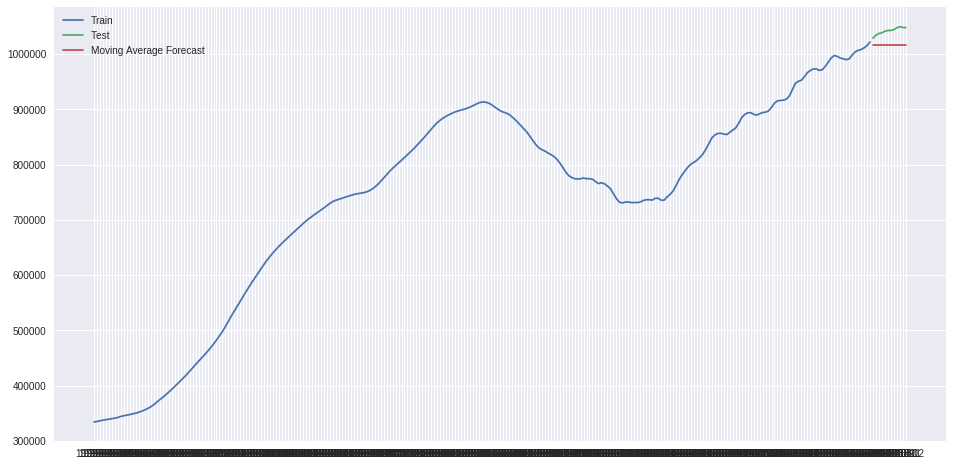

In [0]:
y_hat_avg = test.copy()
y_hat_avg['Moving_Avg_Forecast'] = train['Target_Region'].rolling(3).mean().iloc[-1]
plt.figure(figsize=(16,8))
plt.plot(train['Target_Region'], label='Train')
plt.plot(test['Target_Region'], label='Test')
plt.plot(y_hat_avg['Moving_Avg_Forecast'], label='Moving Average Forecast')
plt.legend(loc='best')
plt.show()

####Step4: Calculate prediction error

In [0]:
rms1 = np.sqrt(mean_squared_error(test.Target_Region, y_hat_avg.moving_avg_forecast))
rms1

26492.80824844529

####Step5: Use Holt_Winter to predict price in 2018

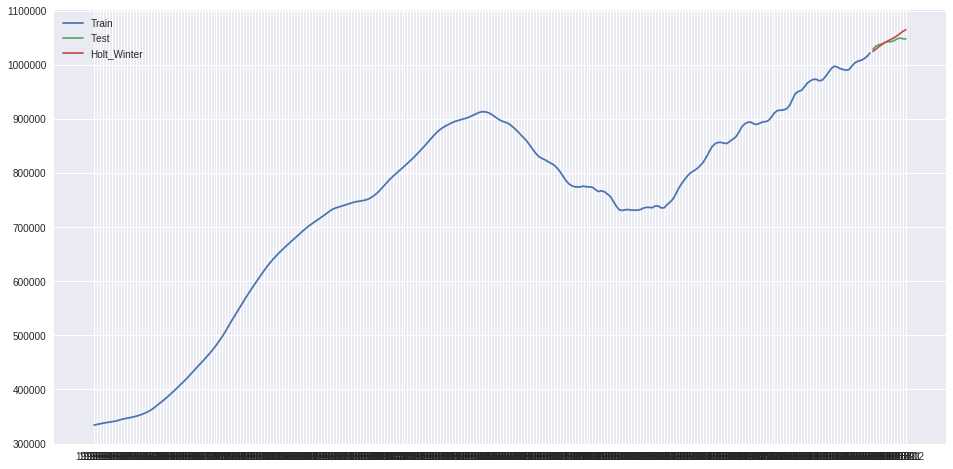

In [0]:
fit = ExponentialSmoothing(np.asarray(train['Target_Region']), seasonal_periods=12 ,trend='add', seasonal='add',).fit()
y_hat_avg['Holt_Winter'] = fit.forecast(len(test))
plt.figure(figsize=(16,8))
plt.plot( train['Target_Region'], label='Train')
plt.plot(test['Target_Region'], label='Test')
plt.plot(y_hat_avg['Holt_Winter'], label='Holt_Winter')
plt.legend(loc='best')
plt.show()

In [0]:
rms2 = np.sqrt(mean_squared_error(test.Target_Region, y_hat_avg.Holt_Winter))
rms2

7530.6552884413195

###Method two: Machine learning (Regression)

####Step1: Select two regions in the same city

In [0]:
sample_region = df_transposed.ix['1996-04':'2018-12',[0,2,7]]
sample_region.head()

,0,2,7
1996-04,334200.000,498100.000,216500.000
1996-05,335400.000,500900.000,216700.000
1996-06,336500.000,503100.000,216900.000
1996-07,337600.000,504600.000,217000.000
1996-08,338500.000,505500.000,217100.000


####Step2: Rename column and format datatype

In [0]:
pd.options.display.float_format = '{:,.0f}'.format
sample_region = pd.DataFrame(sample_region)
sample_region.rename(columns={0: "Target_Region", 2: "RegionA", 7: "RegionB"}, inplace=True)
sample_region.head()

,Target_Region,RegionA,RegionB
1996-04,"334,200","498,100","216,500"
1996-05,"335,400","500,900","216,700"
1996-06,"336,500","503,100","216,900"
1996-07,"337,600","504,600","217,000"
1996-08,"338,500","505,500","217,100"


####Step3: Plot housing prices of these three regions

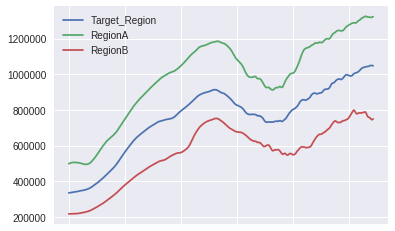

In [0]:
sample_region.plot()

####Step4: Split train/test

In [0]:
X_train = sample_region.ix['1996-04':'2017-12', ["RegionA", "RegionB"]]
X_test = sample_region.ix['2018-01':'2018-12', ["RegionA", "RegionB"]]

y_train = sample_region.ix['1996-04':'2017-12', ["Target_Region"]].values
y_train = y_train.reshape(-1, 1) 

y_test = sample_region.ix['2018-01':'2018-12', ["Target_Region"]].values
y_test = y_test.reshape(-1, 1) 

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:1: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  """Entry point for launching an IPython kernel.


####Step5: Predict prices of the target region based on regions in the same city

In [0]:
reg = linear_model.LinearRegression()
reg.fit(X_train, y_train)
y_pred = reg.predict(X_test)

####Step6: Calculate prediction error

In [0]:
rms3 = np.sqrt(mean_squared_error(y_test, y_pred))
rms3

21379.24455673431

## Conclusion



*   What did you find out from the two models?
*   What pricing prediction can you make?



In [0]:
y_hat_avg['Linear_Regression'] = y_pred
y_hat_avg.head()

,Target_Region,Moving_Avg_Forecast,Holt_Winter,Linear_Regression
2018-01,1028900,"1,016,267","1,024,904","1,018,220"
2018-02,1034500,"1,016,267","1,029,274","1,022,031"
2018-03,1037400,"1,016,267","1,033,716","1,024,063"
2018-04,1038700,"1,016,267","1,037,466","1,026,759"
2018-05,1041500,"1,016,267","1,041,070","1,029,788"


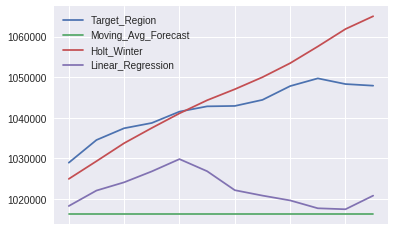

In [0]:
y_hat_avg.plot()

In order to compare time series and machine learning model in real estate price prediction, this project uses one region as an example to compare the prediction error of both models.

* In time series model, we use both moving average and Holt Winter method. The Moving Average model has 26493 mean squared error, and the Holt Winter model reduces mean squared error from 26493 to 7531. 

* In machine learning model, we use linear regression to fit prices of two other regions in the same city to our target region. This gives us 21379 mean squared error.

Thus, when predicting time series data, using time series model (prediction based on trends)is better than machine learning model (prediction based on variables).
